In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
%reload_ext dotenv

%dotenv ../../env/.env

import warnings
import utils
from pandas import Timedelta
import time
from utils import logger, sql_to_df, run_sql, session, conn
import pandas as pd
warnings.filterwarnings('ignore')

try:
    %load_ext autotime
except:
    !pip install ipython-autotime
    %load_ext autotime

12:52:13 INFO:Snowflake Connector for Python Version: 2.7.12, Python Version: 3.8.16, Platform: macOS-10.15.7-x86_64-i386-64bit
12:52:13 INFO:This connection is in OCSP Fail Open Mode. TLS Certificates would be checked for validity and revocation status. Any other Certificate Revocation related exceptions or OCSP Responder failures would be disregarded in favor of connectivity.
12:52:13 INFO:Setting use_openssl_only mode to False
12:52:14 INFO:Snowflake Connector for Python Version: 2.7.12, Python Version: 3.8.16, Platform: macOS-10.15.7-x86_64-i386-64bit
12:52:14 INFO:This connection is in OCSP Fail Open Mode. TLS Certificates would be checked for validity and revocation status. Any other Certificate Revocation related exceptions or OCSP Responder failures would be disregarded in favor of connectivity.


connected to account OMWYKHW-US_WEST_2 wh DEMO db SHARE_COPY schema KNOT_STORAGE_SANDBOX with role DEV


12:52:15 INFO:Snowpark Session information: 
"version" : 1.3.0,
"python.version" : 3.8.16,
"python.connector.version" : 2.7.12,
"python.connector.session.id" : 9098488784932962,
"os.name" : Darwin



time: 20.8 ms (started: 2023-05-03 12:52:15 -04:00)


In [3]:
# %conda install "snowflake-connector-python[pandas]"


In [2]:
# Create a cursor object.
import pandas as pd
def run_sql(sql: str, ctx=conn):
    return conn.cursor().execute(sql)

import functools
import time

@functools.cache
def sql_to_df(sql_query, pre_hook=[], ctx=conn):
    print(f"RUNNING pre-hook: {pre_hook}")
    for s in pre_hook:
        run_sql(s,conn)
        # print(f"RUNNING SQL: {sql_query}")

    # todo: move to latest method of pandas dataframe fetching
    # may need to upgrade python: https://github.com/snowflakedb/snowflake-connector-python/issues/986#issuecomment-1115354587
    
    trimmed_lowered = sql_query.strip().lower()
    if trimmed_lowered.startswith('select') or trimmed_lowered.startswith('with'):
        print(f"using arrow to fetch results...")
        cur = ctx.cursor()
        cur.execute(sql_query)
        data = cur.fetch_pandas_all() 
        cur.close()
    else:
        data = pd.read_sql(
            sql_query,
            ctx,
        )
    
    data.columns = data.columns.str.lower()
    return data

In [5]:
%%markdown
# Idle Time 
We compute: 
- idle time for warehouse 
- some ballpark/conservative estimates for savings based on 20% idle time reduction

# Idle Time 
We compute: 
- idle time for warehouse 
- some ballpark/conservative estimates for savings based on 20% idle time reduction


12:52:20 INFO:query: [with a as (  select * exclude dollars_used_idle from warehouse_profile ) select ...]


using arrow to fetch results...


12:52:20 INFO:query execution done


,auto_suspend,warehouse_id,warehouse_name,start_hour,end_hour,warehouse_sizes,max_cluster_number,active_hours,idle_hours,pct_idle,dollars_used_compute,credits_used_single_cluster_inferred,dollars_used_single_cluster_inferred,dollars_used_addtl_clusters_inferred,dollars_used_idle,dollars_used_active,cost_savings_estimate,cost_savings_estimate_annualized,cost_savings_estimate_pct
8,60,30,OPTIML_WH,2023-04-17 09:00:00-07:00,2023-04-18 23:00:00-07:00,"[\n ""X-Small"",\n ""Medium""\n]",1,1.633005,1.112219,68.108771,6.301167,2.778098,6.111815,0.000000,4.291647,2.009520,0.858329,10.299953,13.621754
7,60,17,XOGRP_WH,2023-02-17 23:00:00-08:00,2023-04-18 23:00:00-07:00,"[\n ""X-Small""\n]",1,23.755497,17.454570,73.475921,52.490167,23.862915,52.460889,0.000000,38.567633,13.922533,7.713527,92.562320,14.695184
6,60,28,DBT_WH,2023-03-20 14:00:00-07:00,2023-04-18 17:00:00-07:00,"[\n ""Large"",\n ""X-Small"",\n ""Medium""\n]",2,49.019962,10.549794,21.521425,947.895056,350.756435,771.358850,176.536205,166.007414,781.887642,33.201483,398.417793,3.502654
4,60,20,XOGRP_DEV_ADHOC,2023-02-27 06:00:00-08:00,2023-04-18 15:00:00-07:00,"[\n ""Medium"",\n ""Large"",\n ""X-Large"",\n ""2...",1,81.077879,16.826981,20.754096,1317.294611,590.660164,1298.936980,0.000000,273.392588,1043.902023,54.678518,656.142212,4.150819
1,60,23,LOCAL_LOAD_WH,2023-02-17 11:00:00-08:00,2023-04-18 16:00:00-07:00,"[\n ""X-Small""\n]",4,535.986435,291.980376,54.475329,1913.808111,537.024853,1181.454677,732.353434,643.601327,1270.206784,128.720265,1544.643185,6.725871
0,60,19,XOGRP_DEV_WH,2023-02-17 17:00:00-08:00,2023-04-18 23:00:00-07:00,"[\n ""X-Small""\n]",4,1067.864439,339.735809,31.814507,2861.617000,1068.858597,2351.488914,510.128086,748.114611,2113.502389,149.622922,1795.475067,5.228615
5,60,29,SEGMENT_BACKFILL_TEMP,2023-03-16 15:00:00-07:00,2023-04-18 23:00:00-07:00,"[\n ""Medium"",\n ""Large"",\n ""X-Large"",\n ""2...",2,473.092556,28.548905,6.034528,3878.335389,1758.347181,3864.036544,14.298844,233.176383,3645.159006,46.635277,559.623320,1.202456
3,60,27,SEGMENT_LOAD_WH,2023-02-17 11:00:00-08:00,2023-04-18 23:00:00-07:00,"[\n ""X-Small""\n]",4,1142.904770,175.268728,15.335375,4522.317556,1142.904770,2514.390493,2007.927062,385.591202,4136.726354,77.118240,925.418884,1.705281
2,60,4,LOAD_WH,2023-02-17 16:00:00-08:00,2023-04-18 23:00:00-07:00,"[\n ""Medium"",\n ""X-Small""\n]",5,1446.606700,119.324326,8.248567,13434.285944,2742.710595,6033.963310,7400.322635,497.715521,12936.570423,99.543104,1194.517250,0.740963


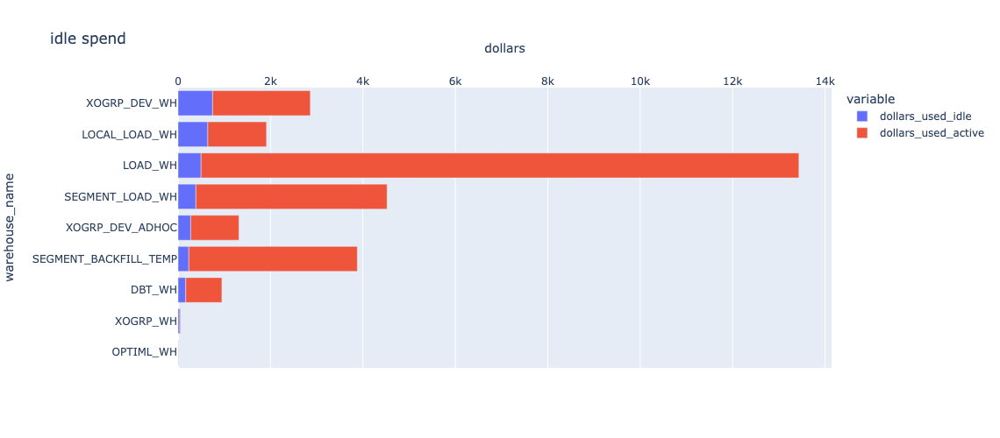

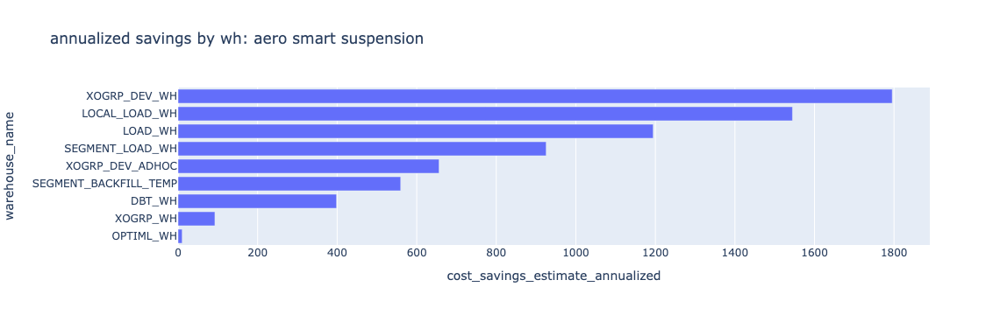

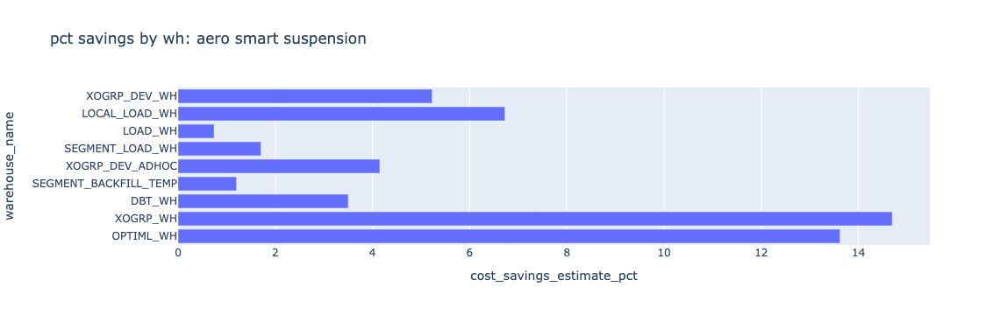

time: 2.37 s (started: 2023-05-03 12:52:19 -04:00)


In [3]:
from IPython.display import display
import plotly.express as px

sql = """
with a as (

select 
    * exclude dollars_used_idle
from warehouse_profile
)
select
    *,
    case when max_cluster_number = 1 then 0 else dollars_used_compute - dollars_used_single_cluster_inferred end as dollars_used_addtl_clusters_inferred,
    (dollars_used_compute - dollars_used_addtl_clusters_inferred) *pct_idle/100 as dollars_used_idle,
    dollars_used_compute - dollars_used_idle as dollars_used_active,
    dollars_used_idle * 0.2 as cost_savings_estimate,
    12 * cost_savings_estimate as cost_savings_estimate_annualized,
    100* cost_savings_estimate / dollars_used_compute as cost_savings_estimate_pct
from a
order by dollars_used_idle desc;
"""
df = sql_to_df(sql)
display(df.sort_values('dollars_used_compute'))
fig = px.bar(
    df.sort_values('dollars_used_idle', ascending=True).tail(10), 
    y="warehouse_name", 
    x=["dollars_used_idle", 'dollars_used_active'], 
    # color = 'wh_utilization_status', 
    # color_discrete_sequence=['blue', 'green', 'red'],
    title = "idle spend",
    orientation='h',
    height=500
)

fig.update_layout(
    xaxis={'side': 'top'}, 
    xaxis_title="dollars"
)
fig.show()

fig = px.bar(
    df.sort_values('dollars_used_idle', ascending=True).tail(10), 
    y="warehouse_name", 
    x='cost_savings_estimate_annualized', 
    # color = 'wh_utilization_status', 
    # color_discrete_sequence=['blue', 'green', 'red'],
    title = "annualized savings by wh: aero smart suspension",
    orientation='h',
    height=100
)

fig.show()
# fig.update_layout(
#     xaxis={'side': 'top'}, 
#     xaxis_title="dollars"
# )
fig = px.bar(
    df.sort_values('dollars_used_idle', ascending=True).tail(10), 
    y="warehouse_name", 
    x='cost_savings_estimate_pct', 
    # color = 'wh_utilization_status', 
    # color_discrete_sequence=['blue', 'green', 'red'],
    title = "pct savings by wh: aero smart suspension",
    orientation='h',
    height=100
)
fig.show()

# fig.update_layout(
#     xaxis={'side': 'top'}, 
#     xaxis_title="dollars"
# )

# fig = px.bar(
#     df.sort_values('pct_idle', ascending=True), 
#     y="warehouse_name", 
#     x='pct_idle', 
#     # color = 'wh_utilization_status', 
#     # color_discrete_sequence=['blue', 'green', 'red'],
#     title = "pct_idle",
#     orientation='h',
#     height=2000
# )
# fig.show()

In [7]:
%%markdown
# Idle Time Deep Dive (WIP)

# Idle Time Deep Dive (WIP)


RUNNING pre-hook: []
using arrow to fetch results...


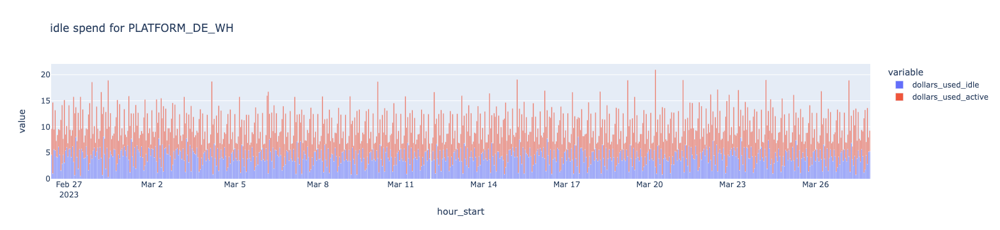

In [8]:
sql = """
select 
    * exclude dollars_used_idle, 
    case when max_cluster_number = 1 then 0 else dollars_used_compute - dollars_used_single_cluster_inferred end as dollars_used_addtl_clusters_inferred,
    (dollars_used_compute - dollars_used_addtl_clusters_inferred) *pct_idle/100 as dollars_used_idle,
    dollars_used_compute - dollars_used_idle as dollars_used_active,
    dollars_used_idle * 0.2 as cost_savings_estimate,
    div0(100* cost_savings_estimate, dollars_used_compute) as cost_savings_estimate_pct
from warehouse_profile_by_hour
order by cost_savings_estimate desc;
"""
df = sql_to_df(sql)
df = df[df.warehouse_name == 'PLATFORM_DE_WH']

fig = px.bar(
    df, 
    x="hour_start", 
    y=["dollars_used_idle", 'dollars_used_active'], 
    # color = 'wh_utilization_status', 
    # color_discrete_sequence=['blue', 'green', 'red'],
    title = "idle spend for PLATFORM_DE_WH",
    # orientation='h',
    # height=100
)
fig.show()

In [9]:
%%markdown
## --> some warehouses have significant idle time. This could be cut with more aggressive shutdowns and/or packing workloads onto fewer warehouses.

## --> some warehouses have significant idle time. This could be cut with more aggressive shutdowns and/or packing workloads onto fewer warehouses.


In [10]:
%%markdown
# Warehouse Resource Utilization
### Search for warehouses with queries that could be run on a smaller warehouse
### This would motivate resizing the warehouse or moving those queries to a smaller warehouse.

# Warehouse Resource Utilization
### Search for warehouses with queries that could be run on a smaller warehouse
### This would motivate resizing the warehouse or moving those queries to a smaller warehouse.


01:22:35 INFO:query: [with a as ( select warehouse_name, case when data_spilled_to_remote_storage_gb >...]


using arrow to fetch results...


01:22:39 INFO:query execution done


['LOAD_WH', 'DBT_WH', 'XOGRP_DEV_ADHOC', 'SEGMENT_BACKFILL_TEMP', 'OPTIML_WH']

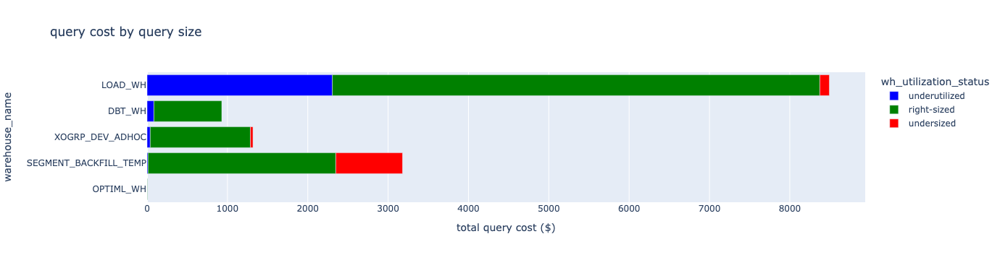

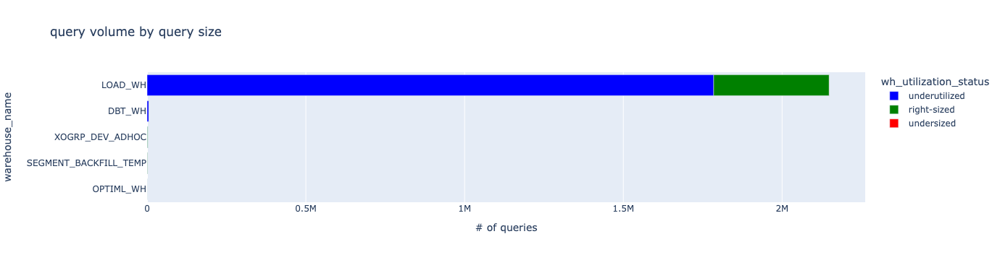

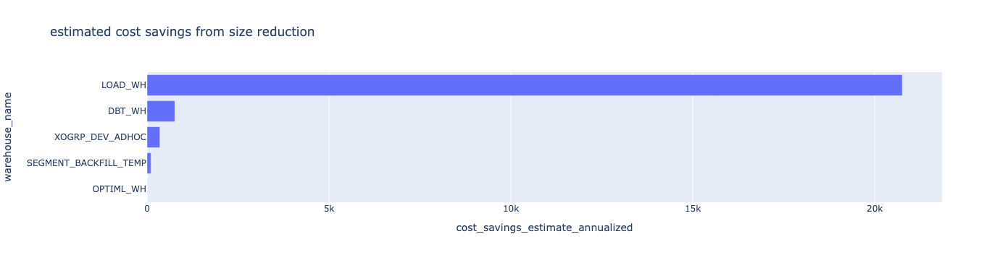

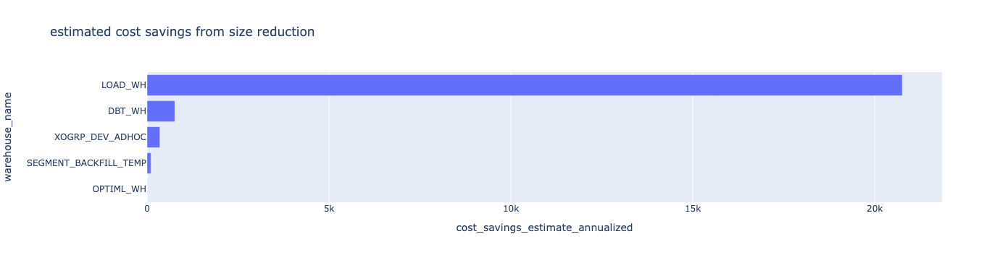

time: 4.01 s (started: 2023-05-03 13:22:35 -04:00)


In [19]:
from IPython.display import display

sql = """
with a as (
select
    warehouse_name,
    case 
        when data_spilled_to_remote_storage_gb > 0 then 'undersized'
        when (execution_time_s < 10 and percentage_scanned_from_cache < 0.9) then 'underutilized'
        else 'right-sized'
    end as wh_utilization_status,
    
    --wh_utilization_status,
    (case when wh_utilization_status = 'underutilized' then 0 
when wh_utilization_status = 'right-sized' then 1 
else 2 end) as status_id,
    count(*) cnt,
    sum(query_cost) total_query_cost
from query_history_enriched
where ran_on_warehouse
and warehouse_size != 'X-Small'
group by 
    warehouse_name,
    wh_utilization_status
),
savings as (
select 
    *,
    first_value(total_query_cost) over (partition by warehouse_name order by status_id) as underutilized_cost,
    sum(total_query_cost) over (partition by warehouse_name) as total_cost,
    case when status_id = 0 then 0.75 * underutilized_cost end as cost_savings_estimate,
    cost_savings_estimate * 12 as cost_savings_estimate_annualized
from a
)
select *
from savings
order by underutilized_cost asc, warehouse_name, status_id
"""

df = sql_to_df(sql)

topten = df[df.status_id == 0].sort_values('total_query_cost', ascending=False).warehouse_name.tolist()
# topten = [
# 'MESSAGE_GEAR_WH',
#  'PLATFORM_DE_WH',
#  'ATSCALE_WH',
# ]
display(topten)
# display(df)
height = len(topten)*35
fig = px.bar(
    df[df.warehouse_name.isin(topten)], 
    y="warehouse_name", 
    x="total_query_cost", 
    color = 'wh_utilization_status', 
    color_discrete_sequence=['blue', 'green', 'red'],
    title = "query cost by query size",
    orientation='h',
    height=height
)
fig.update_layout(
    xaxis_title="total query cost ($)"
)

fig.show()


fig = px.bar(
    df[df.warehouse_name.isin(topten)], 
    y="warehouse_name", 
    x="cnt", 
    color = 'wh_utilization_status', 
    color_discrete_sequence=['blue', 'green', 'red'],
    title = "query volume by query size",
    orientation='h',
    height=height
)

fig.update_layout(
    xaxis_title="# of queries"
)
fig.show()


fig = px.bar(
    df[df.warehouse_name.isin(topten)][df.status_id == 0], 
    y="warehouse_name", 
    x="cost_savings_estimate_annualized", 
    # color = 'wh_utilization_status', 
    # color_discrete_sequence=['blue', 'green', 'red'],
    title = "estimated cost savings from size reduction",
    orientation='h',
    height=height
)
fig.show()


fig = px.bar(
    df[df.warehouse_name.isin(topten)][df.status_id == 0], 
    y="warehouse_name", 
    x="cost_savings_estimate_annualized", 
    # color = 'wh_utilization_status', 
    # color_discrete_sequence=['blue', 'green', 'red'],
    title = "estimated cost savings from size reduction",
    orientation='h',
    height=height
)
fig.show()


01:37:44 INFO:query: [with a as ( select warehouse_name, date_trunc('hour', start_time) as ts, mode(wa...]


using arrow to fetch results...


01:37:50 INFO:query execution done


,warehouse_name,ts,warehouse_size,wh_utilization_status,status_id,cnt,total_query_cost,underutilized_cost,total_cost,cost_savings_estimate,cost_savings_estimate_annualized
0,XOGRP_DEV_ADHOC,2023-04-17 11:00:00-07:00,X-Large,underutilized,0,3,0.071298,0.003687,1317.660346,0.002765,0.033181
1,XOGRP_DEV_ADHOC,2023-04-11 12:00:00-07:00,X-Large,underutilized,0,111,2.951158,0.003687,1317.660346,0.002765,0.033181
2,XOGRP_DEV_ADHOC,2023-04-18 06:00:00-07:00,X-Large,underutilized,0,3,0.079087,0.003687,1317.660346,0.002765,0.033181
3,XOGRP_DEV_ADHOC,2023-04-18 13:00:00-07:00,Medium,underutilized,0,2,0.041885,0.003687,1317.660346,0.002765,0.033181
4,XOGRP_DEV_ADHOC,2023-04-16 09:00:00-07:00,Medium,underutilized,0,6,0.101873,0.003687,1317.660346,0.002765,0.033181
...,...,...,...,...,...,...,...,...,...,...,...
2253,LOCAL_LOAD_WH,2023-04-16 05:00:00-07:00,X-Small,right-sized,1,17570,5.926398,3.154167,2000.780355,NaN,NaN
2254,LOCAL_LOAD_WH,2023-04-14 06:00:00-07:00,X-Small,right-sized,1,10183,3.928042,3.154167,2000.780355,NaN,NaN
2255,LOCAL_LOAD_WH,2023-04-09 05:00:00-07:00,X-Small,right-sized,1,21069,6.003333,3.154167,2000.780355,NaN,NaN
2256,LOCAL_LOAD_WH,2023-04-10 08:00:00-07:00,X-Small,right-sized,1,2887,1.961133,3.154167,2000.780355,NaN,NaN


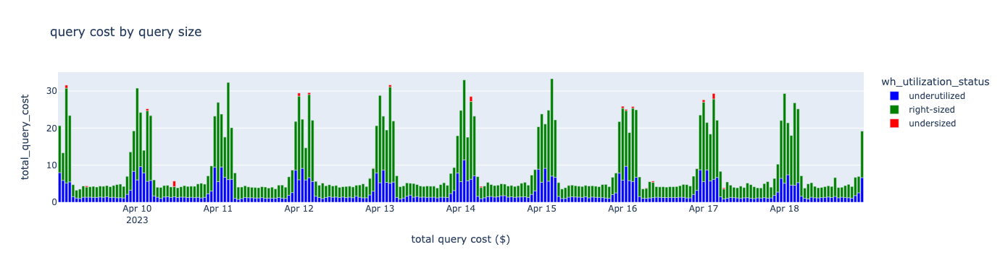

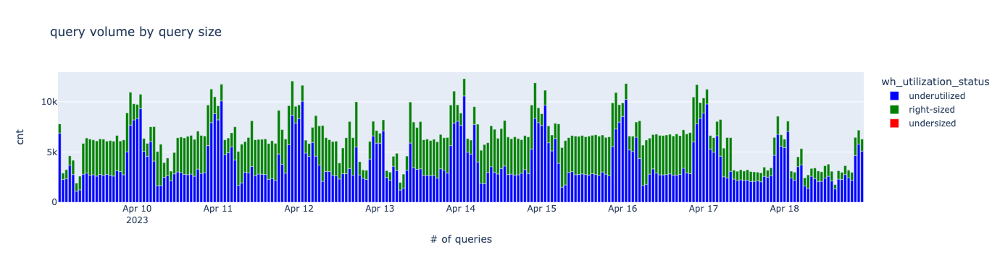

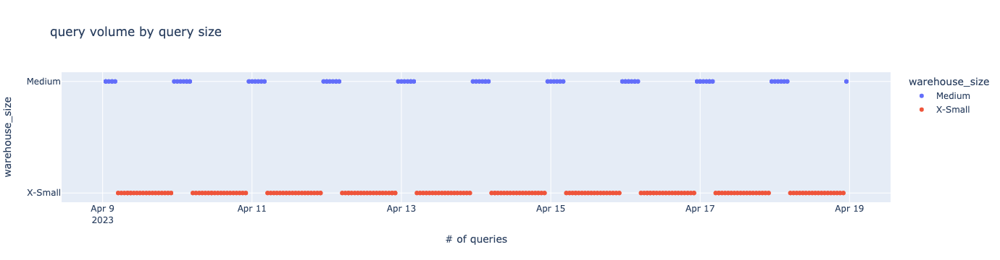

time: 7.04 s (started: 2023-05-03 13:37:44 -04:00)


In [21]:
from IPython.display import display

sql = """
with a as (
select
    warehouse_name,
    date_trunc('hour', start_time) as ts,
    mode(warehouse_size) as warehouse_size,
    case 
        when data_spilled_to_remote_storage_gb > 0 then 'undersized'
        when (execution_time_s < 10 and percentage_scanned_from_cache < 0.9) then 'underutilized'
        else 'right-sized'
    end as wh_utilization_status,
    
    --wh_utilization_status,
    (case when wh_utilization_status = 'underutilized' then 0 
when wh_utilization_status = 'right-sized' then 1 
else 2 end) as status_id,
    count(*) cnt,
    sum(query_cost) total_query_cost
from query_history_enriched
where ran_on_warehouse
--and warehouse_size != 'X-Small'
group by 
    warehouse_name,
    ts,
    wh_utilization_status
),
savings as (
select 
    *,
    first_value(total_query_cost) over (partition by warehouse_name order by status_id) as underutilized_cost,
    sum(total_query_cost) over (partition by warehouse_name) as total_cost,
    case when status_id = 0 then 0.75 * underutilized_cost end as cost_savings_estimate,
    cost_savings_estimate * 12 as cost_savings_estimate_annualized
from a
)
select *
from savings
where ts > '2023-04-09'
order by underutilized_cost asc, warehouse_name, status_id
"""

df = sql_to_df(sql)

# topten = df[df.status_id == 0].sort_values('total_query_cost', ascending=False).warehouse_name.tolist()
topten = [
'LOAD_WH',
 # 'PLATFORM_DE_WH',
 # 'ATSCALE_WH',
]
# display(topten)
display(df)

df[df.warehouse_name.isin(topten)]
height = len(topten)*35
fig = px.bar(
    df[df.warehouse_name.isin(topten)], 
    x="ts", 
    y="total_query_cost", 
    color = 'wh_utilization_status', 
    color_discrete_sequence=['blue', 'green', 'red'],
    title = "query cost by query size",
    # orientation='h',
    height=height
)
fig.update_layout(
    xaxis_title="total query cost ($)"
)

fig.show()


fig = px.bar(
    df[df.warehouse_name.isin(topten)], 
    x="ts", 
    y="cnt", 
    color = 'wh_utilization_status', 
    color_discrete_sequence=['blue', 'green', 'red'],
    title = "query volume by query size",
    # orientation='h',
    height=height
)

fig.update_layout(
    xaxis_title="# of queries"
)
fig.show()


fig = px.scatter(
    df[df.warehouse_name.isin(topten)], 
    x="ts", 
    y="warehouse_size", 
    color = 'warehouse_size', 
    # color_discrete_sequence=['blue', 'green', 'red'],
    title = "query volume by query size",
    # orientation='h',
    height=height
)

fig.update_layout(
    xaxis_title="# of queries"
)
fig.show()

# fig = px.bar(
#     df[df.warehouse_name.isin(topten)][df.status_id == 0], 
#     y="warehouse_name", 
#     x="cost_savings_estimate_annualized", 
#     # color = 'wh_utilization_status', 
#     # color_discrete_sequence=['blue', 'green', 'red'],
#     title = "estimated cost savings from size reduction",
#     orientation='h',
#     height=height
# )
# fig.show()


# fig = px.bar(
#     df[df.warehouse_name.isin(topten)][df.status_id == 0], 
#     y="warehouse_name", 
#     x="cost_savings_estimate_annualized", 
#     # color = 'wh_utilization_status', 
#     # color_discrete_sequence=['blue', 'green', 'red'],
#     title = "estimated cost savings from size reduction",
#     orientation='h',
#     height=height
# )
# fig.show()


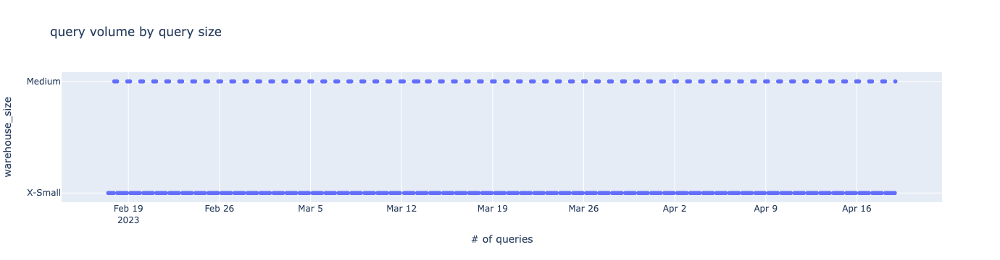

time: 163 ms (started: 2023-05-03 13:20:08 -04:00)


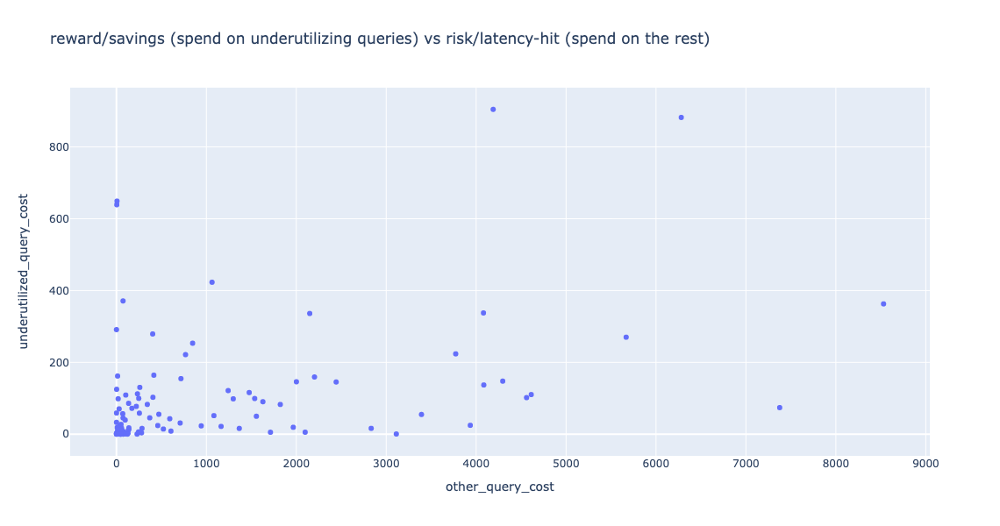

In [4]:
import plotly.express as px

sql = """
with a as (
select
    warehouse_name,
    wh_utilization_status,
    (case when wh_utilization_status = 'underutilized' then 0 
when wh_utilization_status = 'right-sized' then 1 
else 2 end) as status_id,
    count(*) cnt,
    sum(query_cost) total_query_cost
from query_history_narrowed
group by 
    warehouse_name,
    wh_utilization_status
)
select 
    warehouse_name,
    max(case when status_id = 0 then total_query_cost end) as underutilized_query_cost,
    sum(case when status_id != 0 then total_query_cost end) as other_query_cost
from a
group by 1
order by 2 desc nulls last;
"""

df = sql_to_df(sql)

fig = px.scatter(
    df, 
    x="other_query_cost", 
    y='underutilized_query_cost', 
    # color = 'wh_utilization_status', 
    # color_discrete_sequence=['blue', 'green', 'red'],
    title = "reward/savings (spend on underutilizing queries) vs risk/latency-hit (spend on the rest)",
    hover_data=['warehouse_name'],
    # orientation='h',
    height=600
)
fig.show()

In [ ]:
%%markdown
## Warehouses to the top and left are low hanging fruit; reduce their size ASAP. 
## Warheouses at the top and further right would also benefit from size reduction, but costreduction will come with a latency hit!

In [7]:
wh = 'ATSCALE_WH'
sql = f"""
select
    warehouse_name,
    query_load_percent,
    data_scanned_gb,
    data_spilled_to_local_storage_gb,
    data_spilled_to_remote_storage_gb,
    percentage_scanned_from_cache,
    percentage_scanned_from_cache > 0.9 as cache_hit,
    queued_overload_time_s,
    execution_time_s,
    wh_utilization_status
from query_history_narrowed
where warehouse_name = '{wh}'
"""

df = sql_to_df(sql)


RUNNING pre-hook: []
using arrow to fetch results...


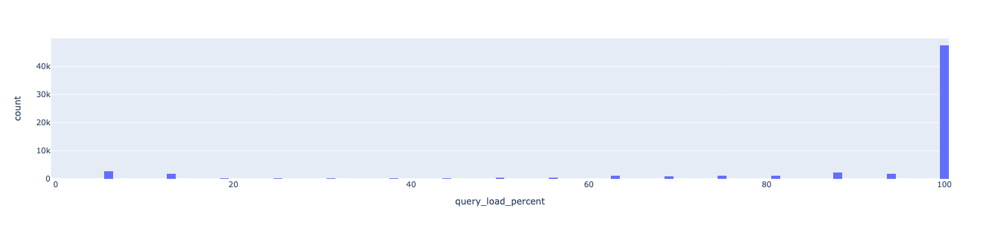

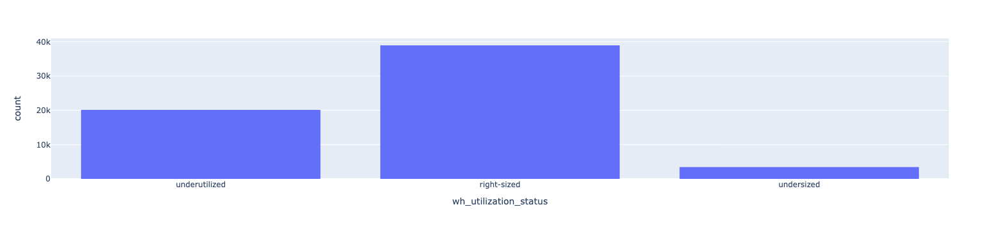

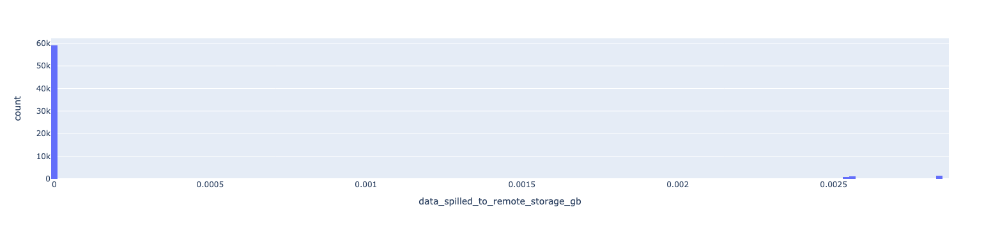

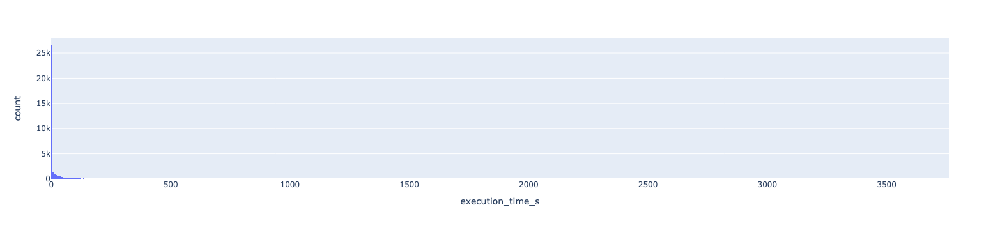

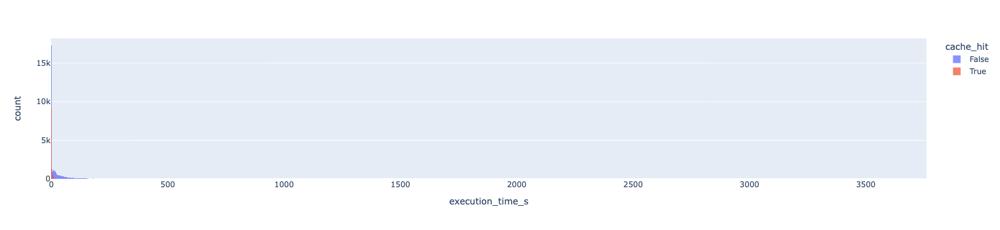

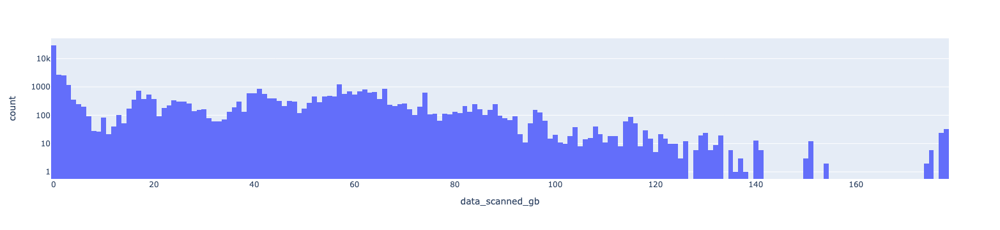

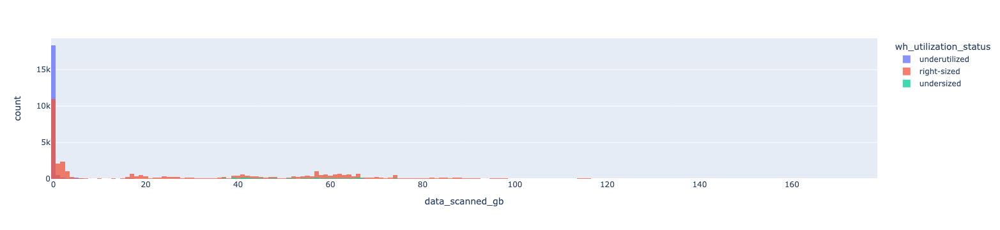

In [8]:
fig = px.histogram(df, x='query_load_percent')
fig.show()

fig = px.histogram(df, x='wh_utilization_status')
fig.show()

fig = px.histogram(df, x='data_spilled_to_remote_storage_gb')
fig.show()

fig = px.histogram(df, x='execution_time_s')
fig.show()

fig = px.histogram(df, x='execution_time_s', color='cache_hit')
fig.update_layout(barmode='overlay')
# Reduce opacity to see both histograms
fig.update_traces(opacity=0.75)
fig.show()

fig = px.histogram(df, x='data_scanned_gb', log_y=True)
fig.show()

fig = px.histogram(df, x='data_scanned_gb', color='wh_utilization_status')
fig.update_layout(barmode='overlay')
# Reduce opacity to see both histograms
fig.update_traces(opacity=0.75)
fig.show()

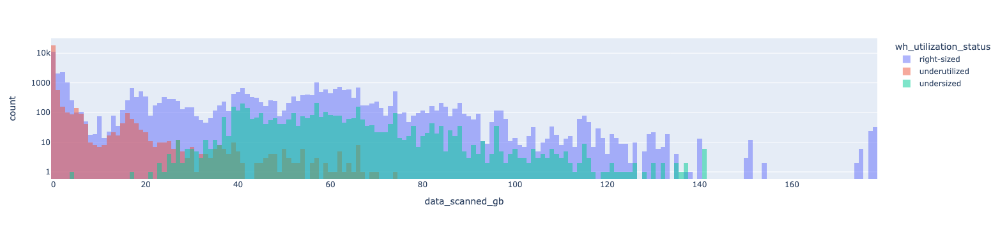

In [31]:

fig = px.histogram(df, x='data_scanned_gb', color='wh_utilization_status', log_y=True)
fig.update_layout(barmode='overlay')
# Reduce opacity to see both histograms
fig.update_traces(opacity=0.5)
fig.show()

In [ ]:
fig = px.density_heatmap(df, x="data_scanned_gb", y="execution_time_s", nbinsx=1000, nbinsy=1000)
fig.show()

In [ ]:
fig = px.histogram(df, x='execution_time_s', log_x=True)
fig.show()

In [ ]:
df.columns

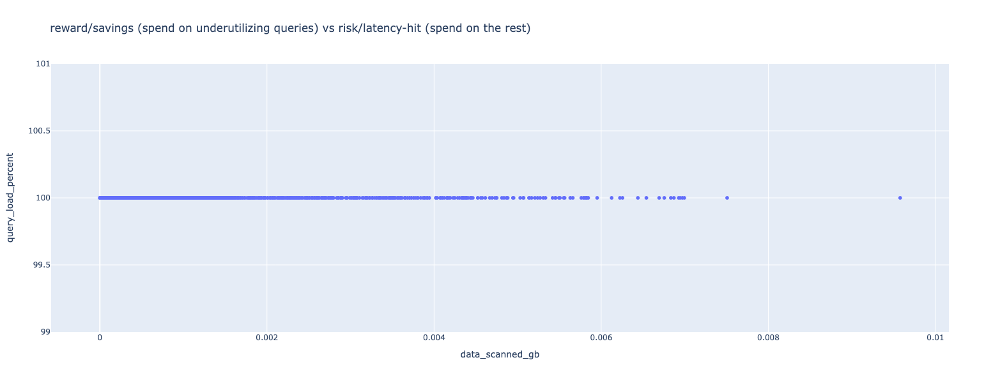

In [28]:
fig = px.scatter(
    df, 
    x="data_scanned_gb", 
    y='query_load_percent', 
    # color = 'wh_utilization_status', 
    # color_discrete_sequence=['blue', 'green', 'red'],
    title = "reward/savings (spend on underutilizing queries) vs risk/latency-hit (spend on the rest)",
    hover_data=['warehouse_name'],
    # orientation='h',
    height=600
)
fig.show()

In [ ]:
df.head(10)

In [ ]:
%%markdown
# SCRATCH
---------

In [ ]:
sql = """
with underutilizing_query_cost as (
    select
        warehouse_id,
        warehouse_name,
        -- wh_utilization_status,
        count(*) cnt,
        sum(query_cost) total_query_cost
    from query_history_narrowed
    where wh_utilization_status = 'underutilized'
    group by 
        warehouse_id, warehouse_name
),
idle_cost as (
    select 
        * exclude credits_used_idle, 
        case when max_cluster_number = 1 then 0 else credits_used_compute - credits_used_inferred end as credits_used_addtl_clusters,
        (credits_used_compute - credits_used_addtl_clusters) *pct_idle/100 as credits_used_idle,
        credits_used_compute - credits_used_idle as credits_used_active
    from warehouse_profile
    -- order by credits_used_idle desc
),
wh_load as (
    select 
        warehouse_id,
        warehouse_name,
        avg(avg_running) avg_running,
        avg(avg_queued_load) avg_queued_load,
        median(avg_queued_load) median_queued_load
    from 
        stg_warehouse_load_history
    where start_time > (select min(start_time) from query_history_narrowed)
    group by 1,2
)
select 
    i.*,
    w.avg_running,
    w.avg_queued_load,
    median_queued_load,
    coalesce(u.cnt, 0) as cnt,
    coalesce(u.total_query_cost, 0) as underutilized_query_spend,
    
    credits_used_idle + underutilized_query_spend as estimated_waste_total,
    credits_used_idle*0.2 + underutilized_query_spend*0.5 as estimated_cost_savings,
    100*estimated_cost_savings/credits_used_compute as estimated_cost_savings_pct
from idle_cost i
full outer join underutilizing_query_cost  u
on i.warehouse_name = u.warehouse_name and i.warehouse_id = u.warehouse_id
left join wh_load w
on i.warehouse_name = w.warehouse_name and i.warehouse_id = w.warehouse_id
order by estimated_waste_total desc
;
"""

df = sql_to_df(sql, ['set lookback_days=30'])
df

In [ ]:
sql = """
with qhe as (
select 
    *    
from
    qhe_lookback
),
stats as (
select
    warehouse_name,
    date_trunc('day', execution_start_time) date,
    wh_utilization_status,
    count(*) cnt,
    sum(query_cost) total_query_cost
from qhe
group by 
    warehouse_name,date,
    wh_utilization_status
),
wh_utilization_by_date as (
select 
    *,
    100*ratio_to_report(cnt) over (partition by warehouse_name, date) as pct_cnt,
    100*ratio_to_report(total_query_cost) over (partition by warehouse_name, date) as pct_total_query_cost
from stats
)
select * from wh_utilization_by_date
order by warehouse_name, 
(case when wh_utilization_status = 'underutilized' then 0 
when wh_utilization_status = 'right-sized' then 1 
else 2 end) asc
"""
df = sql_to_df(sql, ['set lookback_days=30'])
import plotly.express as px

for wh in candidates:
    fig = px.area(
        df[df.warehouse_name == wh], 
        x="date", 
        y="total_query_cost", 
        color = 'wh_utilization_status', 
        color_discrete_sequence=['blue', 'green', 'red'],
        title = f"[{wh}] query cost x query complexity"
    )
    fig.update_layout(hovermode="x")
    fig.show()

    # fig = px.area(
    #     df[df.warehouse_name == wh], 
    #     x="date", 
    #     y="cnt", 
    #     color = 'wh_utilization_status', 
    #     color_discrete_sequence=['blue', 'green', 'red'],
    #     title = "query count"
    # )
    # fig.update_layout(hovermode="x")
    # fig.show()

In [ ]:

warehouses = df.warehouse_name.unique()
for wh in warehouses[0:10]:

    fig = px.area(
        df[df.warehouse_name == wh], 
        x="date", 
        y="pct_total_query_cost", 
        color = 'wh_utilization_status', 
        color_discrete_sequence=['blue', 'green', 'red'],
        title = "query cost distribution"
    )
    fig.update_layout(hovermode="x")
    fig.show()

    fig = px.area(
        df[df.warehouse_name == wh], 
        x="date", y="pct_cnt", 
        color = 'wh_utilization_status', 
        color_discrete_sequence=['blue', 'green', 'red'],
        title = "query volume distribution"
    )
    fig.update_layout(hovermode="x")

    fig.show()